**THIS NOTEBOOK WAS TESTED IN COLAB ENVIRONMENT USING CPU RUNTIME**

Please read our other notbook first,

This is a preprocessing stage for identifying dynamic objects in a video. Our approach is similar to [DS-SLAM](https://arxiv.org/pdf/1809.08379.pdf).

The dynamic objects are stored and are used during our Dynamic Object Aware GS-SLAM (other notebook)

# Requirements

## Downloadig Datasets

In [8]:
!wget https://cvg.cit.tum.de/rgbd/dataset/freiburg3/rgbd_dataset_freiburg3_walking_xyz.tgz
!tar -xvzf ./rgbd_dataset_freiburg3_walking_xyz.tgz

--2024-02-13 05:00:47--  https://cvg.cit.tum.de/rgbd/dataset/freiburg3/rgbd_dataset_freiburg3_walking_xyz.tgz
Resolving cvg.cit.tum.de (cvg.cit.tum.de)... 131.159.19.110, 2a09:80c0:18::1110
Connecting to cvg.cit.tum.de (cvg.cit.tum.de)|131.159.19.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 527550055 (503M) [application/x-gzip]
Saving to: ‘rgbd_dataset_freiburg3_walking_xyz.tgz.1’

taset_freiburg3_wal  14%[=>                  ]  75.25M  20.7MB/s    eta 22s    ^C
rgbd_dataset_freiburg3_walking_xyz/
rgbd_dataset_freiburg3_walking_xyz/accelerometer.txt
rgbd_dataset_freiburg3_walking_xyz/rgb/
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846318.918047.png
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846313.957927.png
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846318.045949.png
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846318.009897.png
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846331.486219.png
rgbd_dataset_freiburg3_walking_xyz/rgb/1341846336.546024.png
rgbd_

loading rgb and depth images paths:

In [9]:
from PIL import Image
import torchvision.transforms as transforms
import os

# Define the transformation
transform = transforms.ToTensor()


# Define the directories where the images are stored
rgb_dir = 'rgbd_dataset_freiburg3_walking_xyz/rgb/'
depth_dir = 'rgbd_dataset_freiburg3_walking_xyz/depth/'

rgb_paths = sorted([os.path.join(rgb_dir, f) for f in os.listdir(rgb_dir) if f.endswith('.png')])
depth_paths = sorted([os.path.join(depth_dir, f) for f in os.listdir(depth_dir) if f.endswith('.png')])

## Create video

this is only intended for visualization

In [10]:
#! ffmpeg -framerate 25 -i rgbd_dataset_freiburg3_walking_xyz/rgb/%*.png -c:v libx264 -r 25 -pix_fmt yuv420p video.mp4


In [11]:
#! ffmpeg -framerate 25 -i ./output/%d.png -c:v libx264 -r 25 -pix_fmt yuv420p output_SIFT.mp4


## Ultralytics for YOLO

In [13]:
!pip install Ultralytics

# Fundemental Matrix Calculation

I borrowed it from my ACV homeworks.



In [14]:
import numpy as np
import math

def get_normalized_points (points1, points2, height, width):
      T = np.array([[1/width, 0, -0.5], [0, 1/height, -0.5], [0, 0, 1]], dtype=np.float64)
      points1 = np.array(points1, dtype=np.float64)
      points2 = np.array(points2, dtype=np.float64)
      points1_homogeneous = np.hstack((points1, np.ones((points1.shape[0], 1), dtype=np.float64)))
      points2_homogeneous = np.hstack((points2, np.ones((points2.shape[0], 1), dtype=np.float64)))
      points1_normalized  = np.dot(T, points1_homogeneous.T).T
      points2_normalized = np.dot(T, points2_homogeneous.T).T
      return points1_normalized, points2_normalized


def sampson_distance(F, pts1, pts2):
    lines1 = np.dot(F.T, pts2.T).T
    lines2 = np.dot(F, pts1.T).T

    numer = (lines1 * pts1).sum(axis=1)**2 + (lines2 * pts2).sum(axis=1)**2
    denom = lines1[:, :2]**2 + lines2[:, :2]**2
    dist = numer / denom.sum(axis=1)

    return dist


def ransac(points1, points2, threshold, confidence):
    best_inliers = np.zeros(points1.shape[0], dtype=bool)
    num_iterations = 0
    max_iterations = math.log(1 - confidence) / (math.log(1 - 0.5**8))
    print (max_iterations)
    while num_iterations < max_iterations:
        indices = np.random.choice(points1.shape[0], size=8, replace=False)
        pts1_sample = points1[indices]
        pts2_sample = points2[indices]
        F_sample = get_normalized_fundamental_matrix(pts1_sample, pts2_sample)
        dist = sampson_distance(F_sample, points1, points2)
        inliers = dist < threshold
        if inliers.sum() > best_inliers.sum():
            best_inliers = inliers
        inlier_ratio = inliers.sum() / points1.shape[0]
        num_iterations += 1

    F_final = get_normalized_fundamental_matrix(points1[best_inliers], points2[best_inliers])

    return F_final, best_inliers



def get_normalized_fundamental_matrix(points1_normalized, points2_normalized):
    A = []
    for i in range(points1_normalized.shape[0]):
        x1, y1, _ = points1_normalized[i]
        x2, y2, _ = points2_normalized[i]
        A.append([x1 * x2, y1 * x2, x2, x1 * y2, y1 * y2, y2, x1, y1, 1])
    A = np.array(A)
    _, _, V = np.linalg.svd(A)
    f = V[-1]
    F = np.reshape(f, (3, 3))
    U, S, V = np.linalg.svd(F)
    S[-1] = 0
    F = np.dot(U, np.dot(np.diag(S), V))

    return F


# Denoising & Dilation of identified Dynamic Points

In [15]:
import torch.nn.functional as F


def gaussian_kernel_2d(kernel_size, sigma):
    ax = torch.arange(-kernel_size // 2 + 1., kernel_size // 2 + 1.)
    xx, yy = torch.meshgrid(ax, ax)
    kernel = torch.exp(-(xx**2 + yy**2))
    return kernel / kernel.sum()

def create_circular_mask(n):
    x, y = torch.meshgrid(torch.arange(n), torch.arange(n))
    center = n // 2
    distance = ((x - center) ** 2 + (y - center) ** 2) ** 0.5
    mask = (distance < center ).float()

    return mask


def dilate_mask (mask, dilation, threshold = 0):
    if len(mask.shape) == 2:
        mask = np.stack((mask,) * 1, axis=-1)
    mask = torch.from_numpy(mask).float()
    kernel_size = dilation
    filter = create_circular_mask(kernel_size)
    mask = mask.unsqueeze(0).permute(0, 3, 1, 2)
    filter = filter.unsqueeze(0).unsqueeze(0)
    output = F.conv2d(mask, filter, padding=int((dilation - 1) / 2))
    output = output.squeeze(0).permute(1, 2, 0)
    output = torch.where(output < threshold, torch.tensor(0.0), output)
    output = torch.sign(output)
    print (output.shape)

    return output


# Dynamic Object Detection



1.   calculate SIFT or ORB features in frame n
2.   find the coresponding points in frame n+1 using sparse optical flow calculation for out feature points
3. remove outliers in matched pairs
4. we calculate fundemental matrix, we use ransac for outlier rejection
5. for all matched pairs, if p1 distance to epipolar line is greater than a threshold, it is identified as **dynamic**



In [20]:
import cv2
import numpy as np
import torch

def find_dynamic_objects(F1, F2, yolov8_model, feature_extractor, lk_params, eps, threshold, D1, D2, index):
    # 1. Use YOLOv8 model to detect objects and extract masks
    masks, labels = detect_objects_and_extract_masks(F1, yolov8_model)

    # 2. Extract features from F1
    keypoints1, _ = feature_extractor.detectAndCompute(F1, None)

    # 3. Find corresponding points in F2 using calcOpticalFlowPyrLK()
    keypoints2, status, _ = cv2.calcOpticalFlowPyrLK(F1, F2, np.float32([kp.pt for kp in keypoints1]), None, **lk_params)

    # 4. Remove outliers
    keypoints1 = np.float32([keypoints1[i].pt for i, s in enumerate(status) if s])
    keypoints2 = np.float32([keypoints2[i] for i, s in enumerate(status) if s])

    # 5. Calculate fundamental matrix F
    F, mask = cv2.findFundamentalMat(keypoints1, keypoints2, cv2.FM_RANSAC)

    #height, width = F1.shape[0], F1.shape[1]

    #points1_normalized, points2_normalized = get_normalized_points(keypoints1, keypoints2, height, width)

    #F, mask = ransac(points1_normalized, points2_normalized, 0.00001, .99);
    #T = np.array([[1/width, 0, -0.5], [0, 1/height, -0.5], [0, 0, 1]])
    #F = np.dot(T.T, np.dot(F, T))

    moving_points_mask = np.zeros((F2.shape[0], F2.shape[1]))
    # 6. For each matched pair p1 and p2
    S = []
    for i, (p1, p2) in enumerate(zip(keypoints1, keypoints2)):
        # Find epipolar line I1
        I1 = cv2.computeCorrespondEpilines(p2.reshape(-1, 1, 2), 2, F).reshape(-1, 3)
        #a,b,c = (F @ np.array([*p2, 1]))
        #D = abs(a * p1[0] + b * p1[1] + c) / np.sqrt(a**2 + b**2)
        # Calculate distance D from p1 to I1
        D = abs(np.dot(I1, np.array([*p1, 1])))
        # If D > eps, append p2 to S

        if D > eps:
            in_mask = 0
            for mask in masks:
                if p2[1] < mask.shape[0] and p2[0] < mask.shape[1]:
                    in_mask += mask[int(p2[1]), int(p2[0])]
            if in_mask > 0:
              S.append(p2)
              if (p2[1] < moving_points_mask.shape[0] and p2[0] < moving_points_mask.shape[1]):
                  moving_points_mask[int(p2[1]), int(p2[0])] = 1


    # 7. Check all outliers in S
    moving_masks = []
    moving_names = []
    k = 0
    for mask in masks:
        outliers_in_mask = sum(mask[int(p[1]), int(p[0])] for p in S if p[0] < mask.shape[1] and p[1] < mask.shape[0])
        if outliers_in_mask > threshold:
            moving_masks.append(mask)
            moving_names.append(labels[k])
        k += 1

    plot_frames(F1, F2, keypoints1, keypoints2, S, D1, D2)
    #mark_dynamic(F2, keypoints1, keypoints2, S, masks, f"./output/{index}.png")
    #create_mask(F2, moving_points_mask, f"./output/{index}.png")
    return moving_masks, moving_names, moving_points_mask

def detect_objects_and_extract_masks(image, model):
    # Convert image to PyTorch tensor
    if len(image.shape) == 2:
        # If grayscale, add an extra dimension to simulate color channels
        image = np.stack((image,) * 3, axis=-1)

    image_tensor = torch.from_numpy(image).float().permute(2, 0, 1).unsqueeze(0)

    # Perform object detection
    with torch.no_grad():
        detections = model(image_tensor)[0]

    # Extract masks for each detected object
    masks = []
    labels = []

    for detection in detections:
        labels.append(detection.names[detection.boxes.cls.item()])
        #ipdb.set_trace(context=6)
        mask = (detection.masks.data.squeeze().numpy() > 0.5).astype(np.uint8)
        masks.append(mask)

    # Plot the frames and the corresponding feature points
    #plot_masks(masks)
    return masks, labels


# Visualization

In [26]:
import torchvision.io as tio
from PIL import Image
def plot_frames(F1, F2, p1, p2, S, D1, D2, write = False):
    # Convert images to RGB for plotting
    F1_rgb = cv2.cvtColor(F1, cv2.COLOR_GRAY2RGB)
    F2_rgb = cv2.cvtColor(F2, cv2.COLOR_GRAY2RGB)

    # Create dummy keypoint objects
    keypoints1 = [cv2.KeyPoint(x=f[0], y=f[1], size=20) for f in p1]
    keypoints2 = [cv2.KeyPoint(x=f[0], y=f[1], size=20) for f in p2]

    # Draw matches
    matches = [cv2.DMatch(i, i, 0) for i in range(len(keypoints1))]
    img_matches = cv2.drawMatches(F1_rgb, keypoints1, F2_rgb, keypoints2, matches, None)

    # Convert S to a list of tuples
    S_tuples = [tuple(p) for p in S]

    # Mark dynamic keypoints in red
    for i, (p1, p2) in enumerate(zip(keypoints1, keypoints2)):
        if (p2.pt[0], p2.pt[1]) in S_tuples :
            cv2.circle(img_matches, tuple(map(int, p1.pt)), 5, (255, 0, 0), -1)
            cv2.circle(img_matches, tuple((int(p2.pt[0])+640, int(p2.pt[1]))), 5, (255, 0, 0), -1)


    # Plot the images
    plt.figure(figsize=(15, 15))
    plt.imshow(img_matches)
    plt.show()

def create_mask (F2, points_mask, file_path):
    F2 = cv2.cvtColor(F2, cv2.COLOR_GRAY2RGB)
    dilated_mask = dilate_mask(points_mask, 71, 10)
    F2_tensor =  torch.clamp(torch.from_numpy(F2).float()/255+dilated_mask ,0,1)

    image_pil = transforms.ToPILImage()(F2_tensor.permute(2,0,1))
    plt.imshow(image_pil)
    image_pil.save(file_path)

def mark_dynamic (F2, P1, P2, S, masks, file_path):
    S_tuples = [tuple(p) for p in S]
    F2 = cv2.cvtColor(F2, cv2.COLOR_GRAY2RGB)

    for i, (p1, p2) in enumerate(zip(P1, P2)):
        in_mask = 0
        for mask in masks:
            if p2[1] < mask.shape[0] and p2[0] < mask.shape[1]:
                in_mask += mask[int(p2[1]), int(p2[0])]
        if (in_mask > 0 and p2[0], p2[1]) in S_tuples:
            cv2.circle(F2, tuple(((int(p2[0]), int(p2[1])))), 5, (255, 0, 0), -1)
    plt.imshow(F2)
    cv2.imwrite(file_path, F2)


import matplotlib.pyplot as plt

def plot_masks(masks):
    fig, axs = plt.subplots(1, max(2,len(masks)), figsize=(20, 20))

    for i, mask in enumerate(masks):
        axs[i].imshow(mask, cmap='gray')
        axs[i].axis('off')

    plt.show()


# Execuation of Dynamic Detection

processing all the frame is commented, only one frame is processed

We can choose between SIFT and ORB features, ORB was shown to be significantly faster, but SIFT yielded higher quality features

Red points in the output image are the identified dynamic points


WARNING ⚠️ torch.Tensor inputs should be normalized 0.0-1.0 but max value is 254.0. Dividing input by 255.
0: 480x640 2 persons, 1 chair, 1 tv, 1 mouse, 1 keyboard, 236.2ms
Speed: 0.0ms preprocess, 236.2ms inference, 18.6ms postprocess per image at shape (1, 3, 480, 640)


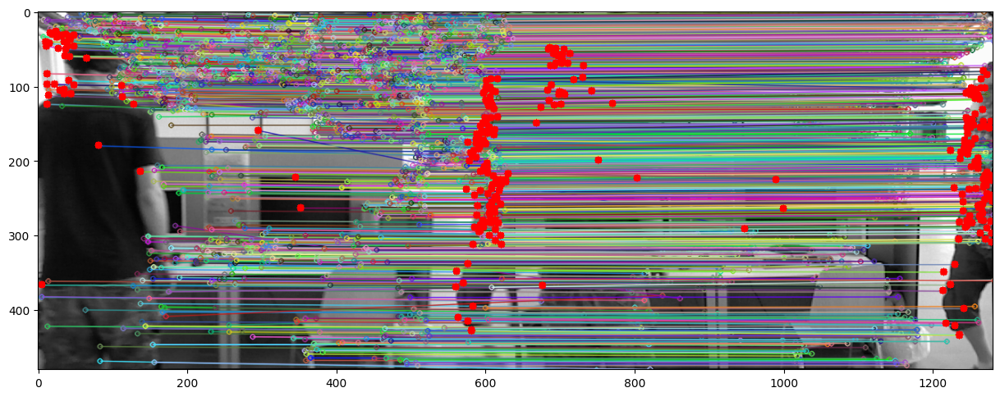

In [23]:
import cv2
import torch
from ultralytics import YOLO

yolov8_model = YOLO('yolov8n-seg.pt')

# Initialize the feature extractor
#feature_extractor = cv2.ORB_create(nfeatures=3000)
feature_extractor = cv2.xfeatures2d.SIFT_create()
#feature_extractor = cv2.xfeatures2d.SURF_create()

# Define parameters for calcOpticalFlowPyrLK()
lk_params = dict(winSize=(15, 15), maxLevel=4, criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

eps = 1.5

threshold = 5

F1 = cv2.imread(rgb_paths[110], cv2.IMREAD_GRAYSCALE)
F2 = cv2.imread(rgb_paths[115], cv2.IMREAD_GRAYSCALE)

'''D1 = cv2.imread(depth_paths[40], cv2.IMREAD_GRAYSCALE)
D2 = cv2.imread(depth_paths[41], cv2.IMREAD_GRAYSCALE)
for i in range (0, len(rgb_paths)):
    F1 = cv2.imread(rgb_paths[i], cv2.IMREAD_GRAYSCALE)
    F2 = cv2.imread(rgb_paths[i+1], cv2.IMREAD_GRAYSCALE)
    moving_masks, moving_names, points_mask = find_dynamic_objects(F1, F2, yolov8_model, feature_extractor, lk_params, eps, threshold, D1, D2, i)'''

moving_masks, moving_names, points_mask = find_dynamic_objects(F1, F2, yolov8_model, feature_extractor, lk_params, eps, threshold, D1, D2, 0)




# Dynamic Masks Using Point Dilation

we tried to create masks for dynamic parts of the scene using our sparse dynamic points. But it didn't work well and we ended up using YOLO.

This is an example, as you can see it can cover parts of our dynamic object, but is not rebust enough.

torch.Size([480, 640, 1])


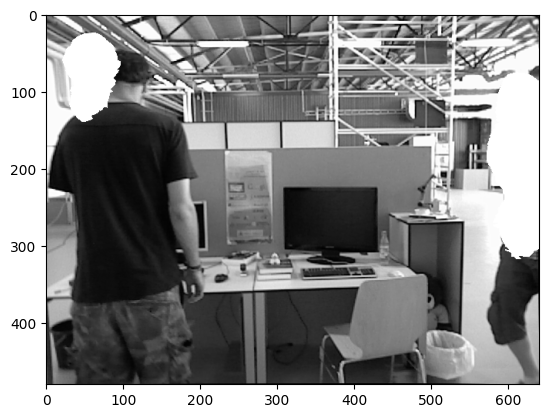

In [27]:
create_mask (F2, points_mask, 'mask.png')


# Some Video Results

**NOTE:** noises are not removed in these video, noise removal was implemented after exporting these videos.

##ORB Result

In [43]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('output_ORB.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## SIFT Result

In [41]:
mp4 = open('output_SIFT.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Mask Generation

In [44]:
mp4 = open('output_Mask.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)